In [1]:
import numpy as np
import jax
import jax.numpy as jnp
import matplotlib.pyplot as plt

In [74]:
n = 10
A = np.random.randn(n,n)  *  1.

# forzo la stabilitá  traslando gli autovalori
autovalori = np.linalg.eig(A)[0]
real_part_autovalori = np.real(autovalori)
lmbd                 = real_part_autovalori.max()

A = A - lmbd * np.eye(n)
lmbd_max = np.abs(np.linalg.eig(A)[0]).max()

tau = 1./ lmbd_max

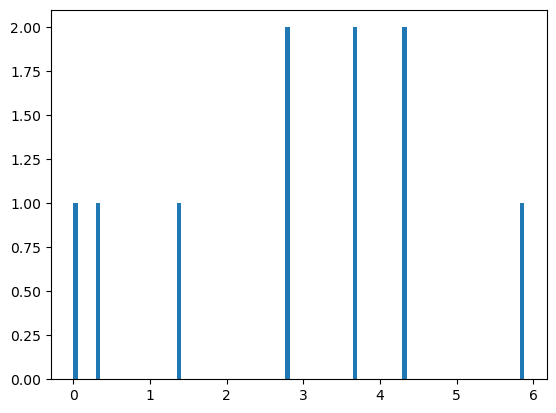

0.16998910148452046

In [75]:
autovalori_traslati = np.linalg.eig(A)[0]
plt.hist( np.abs(autovalori_traslati), bins = 100 )
plt.show()
tau

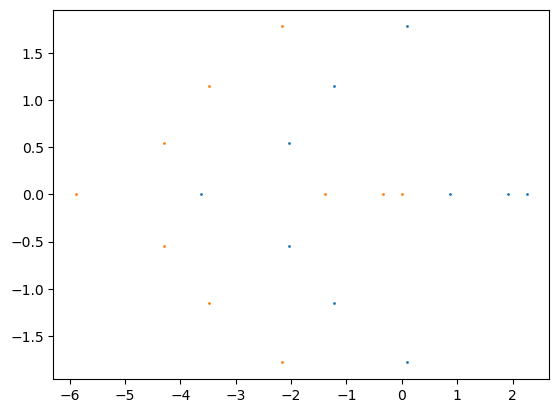

In [76]:
plt.scatter(np.real(autovalori), np.imag(autovalori), s = 1.)
plt.scatter(np.real(autovalori_traslati), np.imag(autovalori_traslati), s = 1.)

plt.show()

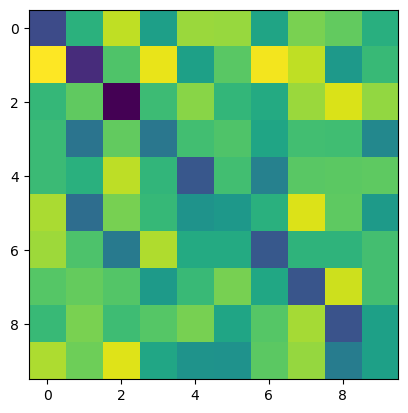

In [77]:
plt.imshow(A)

In [78]:
def simulate(x_0,A,dt):
    x = x_0.copy()
    Y  = []
    for i in range(200):
        x += dt * (A @ x)
        Y.append(x[0])
    return jnp.array(Y)

X = np.random.randn(5000,n)
Y = jax.vmap(lambda x_0: simulate(x_0,A,tau))(X)

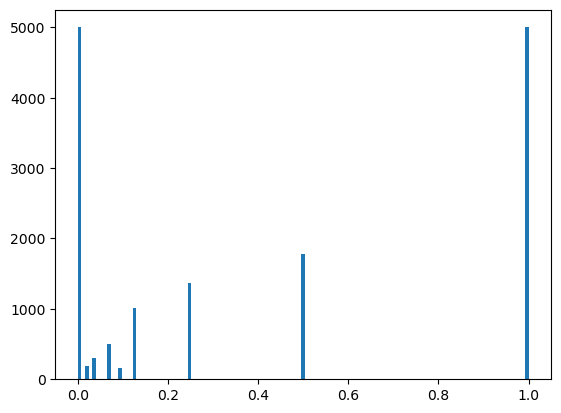

In [90]:
from scipy.interpolate import UnivariateSpline


# Fit a spline to the data

N      = len(Y[0])
knots_set = []
for i in range(len(X)):
    spline = UnivariateSpline(np.linspace(0,1,N), Y[i], s= 1. )
    
    # Get the knots
    knots = list(spline.get_knots())
    knots_set += knots
plt.hist(knots_set, bins = int(np.sqrt(len(knots_set))))
plt.show()

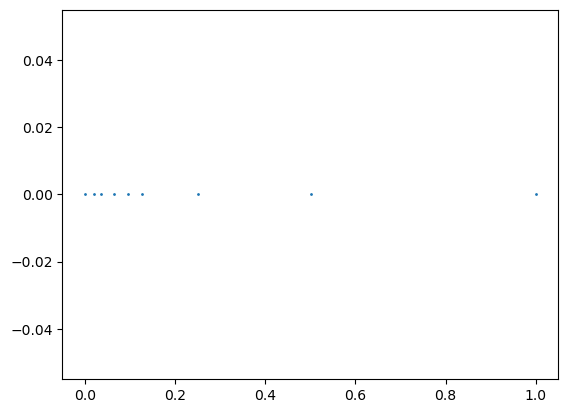

In [96]:
plt.scatter( np.unique(knots_set), 0 *  np.unique(knots_set), s = 1.) 

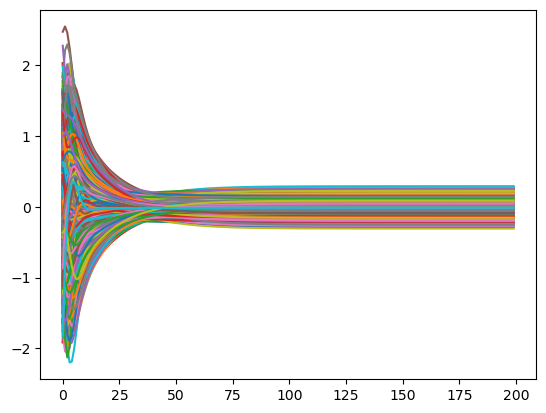

In [79]:
plt.plot(np.array(Y).T)
plt.show()

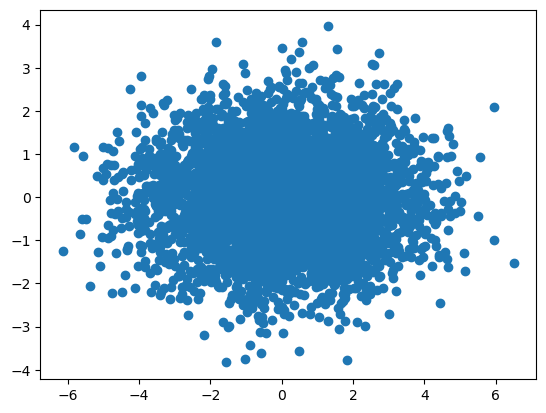

In [81]:
Y_zc   = Y - Y.mean(axis = 0)
U,s,Vt = np.linalg.svd(Y_zc, full_matrices = False)
Y_proj = Y_zc @ Vt.T[:,:2]
plt.scatter(Y_proj[:,0], Y_proj[:,1])

In [82]:
from scipy.interpolate import UnivariateSpline


# Fit a spline to the data

N      = len(Y[0])
knots_set = []
for i in range(len(X)):
    spline = UnivariateSpline(np.linspace(0,1,N), Y[i], s=2)
    
    # Get the knots
    knots = list(spline.get_knots())
    knots_set.append(knots[0])
knots_set = np.array(knots_set)

In [83]:
w = np.linalg.pinv(X[:int(len(X)/2)]) @ Y[:int(len(X)/2)]

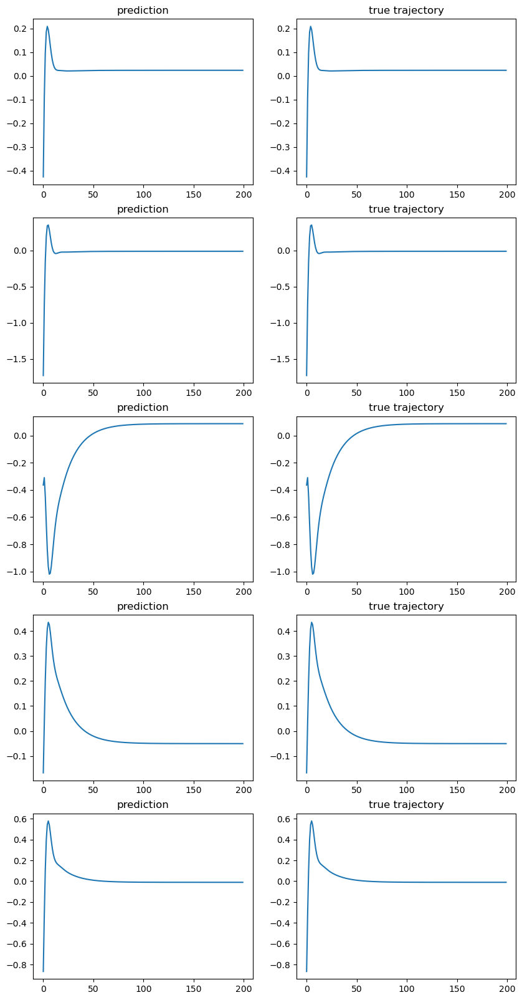

In [84]:
axs = plt.figure(figsize = (10,20)).subplots(nrows = 5, ncols = 2)
for i in range(5):
    axs[i][0].set_title("prediction")
    axs[i][0].plot( (X[-i] @ w) )
    axs[i][1].set_title("true trajectory")
    axs[i][1].plot( Y[-i] )


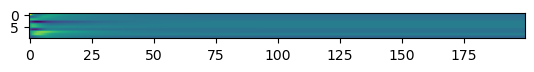

In [85]:
plt.imshow(w)

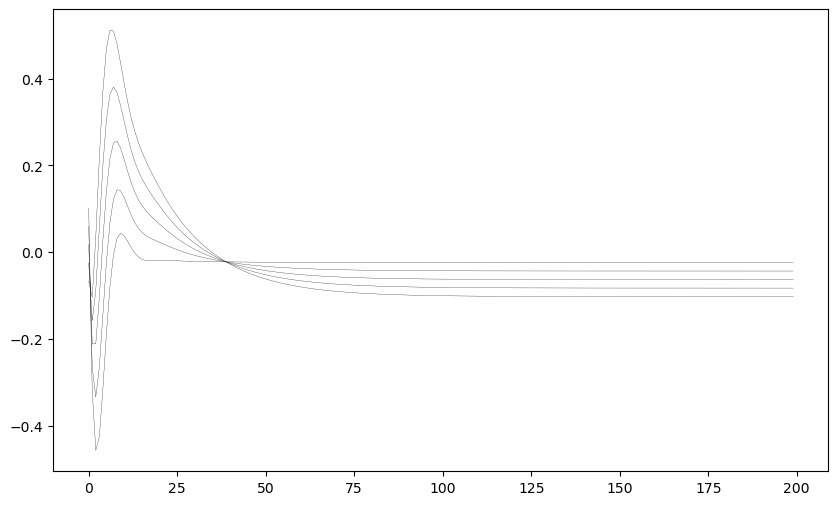

In [87]:
plt.figure(figsize = (10,6))
for a in np.linspace(0,1,5):
    plt.plot( (a * X[-9]  + (1 - a) * X[-12]) @ w , color = 'black', alpha = 1, lw = 0.2)


### Sine data

In [98]:
import numpy as np
import jax
import jax.numpy as jnp
import matplotlib.pyplot as plt

In [220]:
N       = 1500
t_space = np.linspace(0,1,200) 

# dof
omega      = np.random.uniform(size = N) * 30
amplitude  = np.random.uniform(size = N) * 1

X          = jax.vmap(
    lambda o,a:
        a * jnp.sin(t_space * o)
)(omega,amplitude)

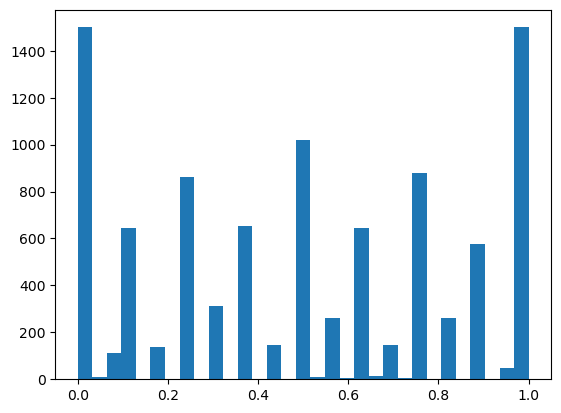

In [221]:
from scipy.interpolate import UnivariateSpline


# Fit a spline to the data

N      = len(Y[0])
knots_set = []
for i in range(len(X)):
    spline = UnivariateSpline(t_space, X[i], s= 1. )
    
    # Get the knots
    knots = list(spline.get_knots())
    knots_set += knots
plt.hist(knots_set, bins = int((np.sqrt(N))))
plt.show()

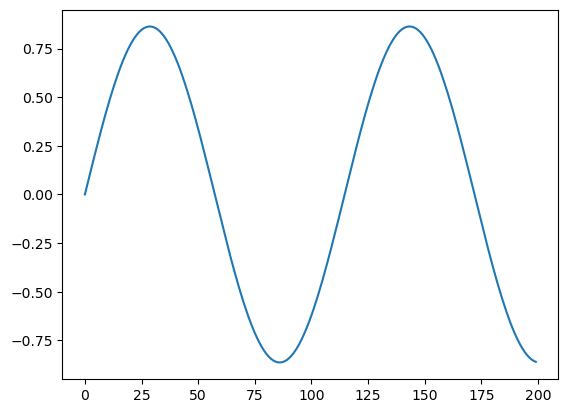

In [222]:
plt.plot(X[2])

## Nadaraya Experiment

In [223]:
def k(x,y):
    return jnp.exp ( - (1e2) * (x - y) @ (x - y) )
    
def predict(x,X,Y):
    # pesi del kernel
    K = jax.vmap(lambda x_i: k(x,x_i)   * ( (x - x_i) @  (x - x_i) > 0 )  )(X)
    print(K.shape)
    # costruzione basata sul kernel
    C = K[:,None] * Y
    # media pesata
    x_hat = C.sum(axis = 0) / K.sum()
    return x_hat

batch_predict = lambda X_in,X,Y : jax.vmap(lambda x: predict(x,X,Y))(X_in) 

E =  np.random.randn(len(X), 1)

@jax.jit
def loss(E,X):
    return ((  batch_predict(E,E,X) -  X )**2).sum()

grad = jax.grad(loss)

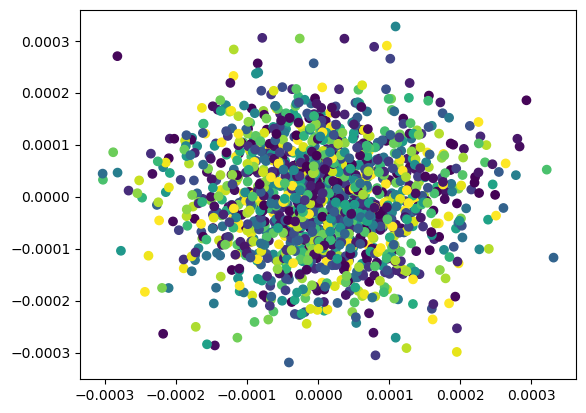

44487.5


98.998 0.000150000000: 100%|███████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [01:44<00:00,  9.55it/s]


In [230]:
from tqdm import tqdm

#E  = np.random.uniform(size = (len(X),2)) * 1e-2
E =  np.random.randn(len(X), 2) *  1e-4
plt.scatter(E[:,0] , E[:,1], c =  t_space[ X.argmax(axis =  1)])
plt.show()

print(loss(E,X))
steps = 1000
bar = tqdm(range(steps))
lr  = 1.5e-4
T   = np.geomspace(1e-4, 1e-9, steps )
mom = E * 0
points = []
for i in bar:
    mom = mom * .9 - lr * grad(E,X)
    E =  E + mom + np.random.normal(size = E.shape) * T[i]
    bar.set_description("%.3f %.12f" % (loss(E,X),lr))
    points.append(E.copy())

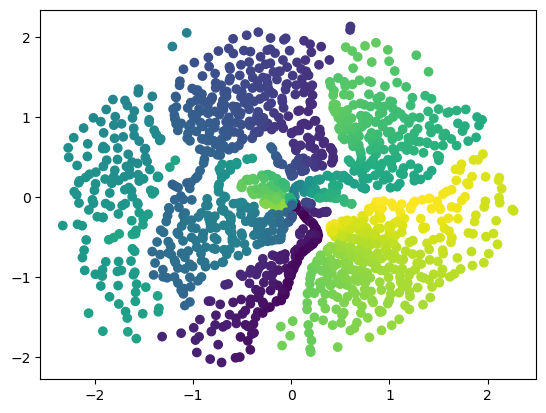

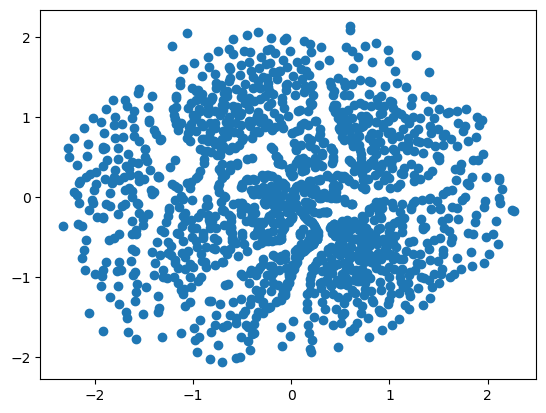

In [231]:
plt.scatter(E[:,0] , E[:,1] , c = omega )
plt.figure()
plt.scatter(E[:,0] , E[:,1])

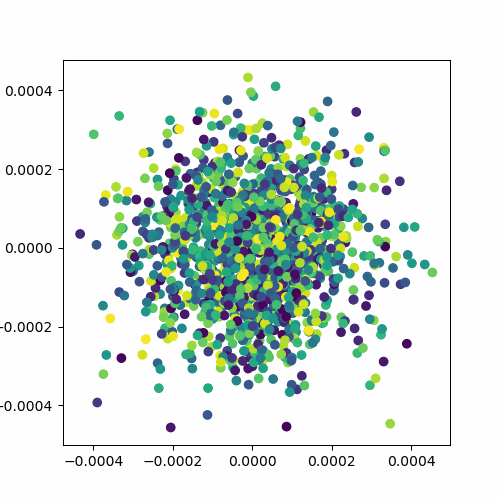

In [232]:
import matplotlib.animation as animation
from IPython.display import HTML
from IPython.display import Image

fig = plt.figure(figsize=(5,5))
ax  = fig.add_subplot()

def frame(w):
    ax.clear()
    embedding = points[w]
    plot = ax.scatter(embedding[:,0],embedding[:,1], c = amplitude)
    return plot
plt.close()

anim = animation.FuncAnimation( fig, frame, frames = len(points), repeat = True)
anim.save("omeo.gif", writer = 'mencoder', fps = 33)

Image("omeo.gif")